<a href="https://colab.research.google.com/github/LimJiaLe2006/Practical-Discrete-Mathematics/blob/master/opencv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

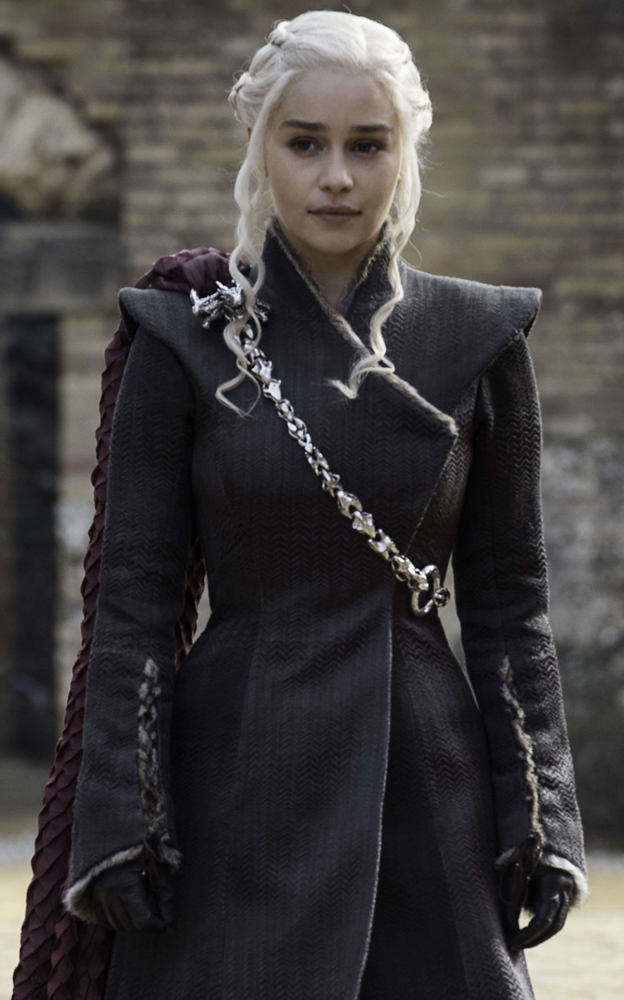

NameError: name 'output' is not defined

In [2]:
from PIL import Image
import requests
from io import BytesIO

# Load the image from the URL
url = "https://vignette.wikia.nocookie.net/gameofthrones/images/2/25/707_Daenerys_Profil.jpg/revision/latest?cb=20170829215522&path-prefix=de"
response = requests.get(url)
image = Image.open(BytesIO(response.content))

# Enlarge the image
width, height = image.size
enlarged_image = image.resize((width * 2, height * 2))

# Display the enlarged image
display(enlarged_image)



# Convert the image to grayscale
gray_image = output.convert("L")  # Use 'L' for grayscale

# Display the grayscale image
display(gray_image)

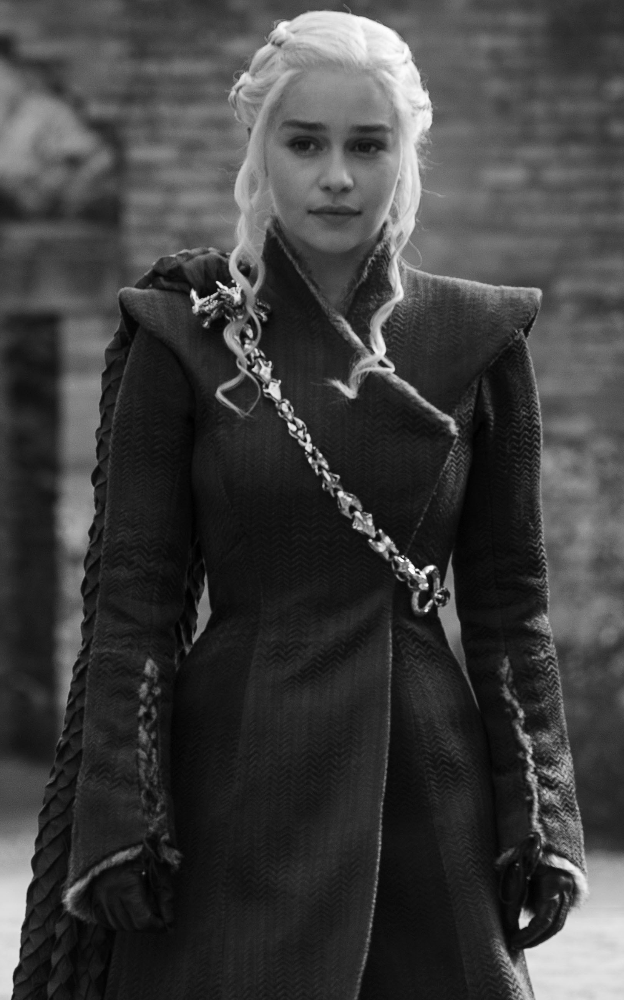

In [3]:
from PIL import Image
import requests
from io import BytesIO

# Load the image from the URL
image_url = "https://vignette.wikia.nocookie.net/gameofthrones/images/2/25/707_Daenerys_Profil.jpg/revision/latest?cb=20170829215522&path-prefix=de"
response = requests.get(image_url)
image = Image.open(BytesIO(response.content))

# Convert the image to grayscale
gray_image = image.convert("L")  # Use 'L' for grayscale

# Display the grayscale image
display(gray_image)

# Optionally, save the grayscale image
# gray_image.save("grayscale_image.jpg")

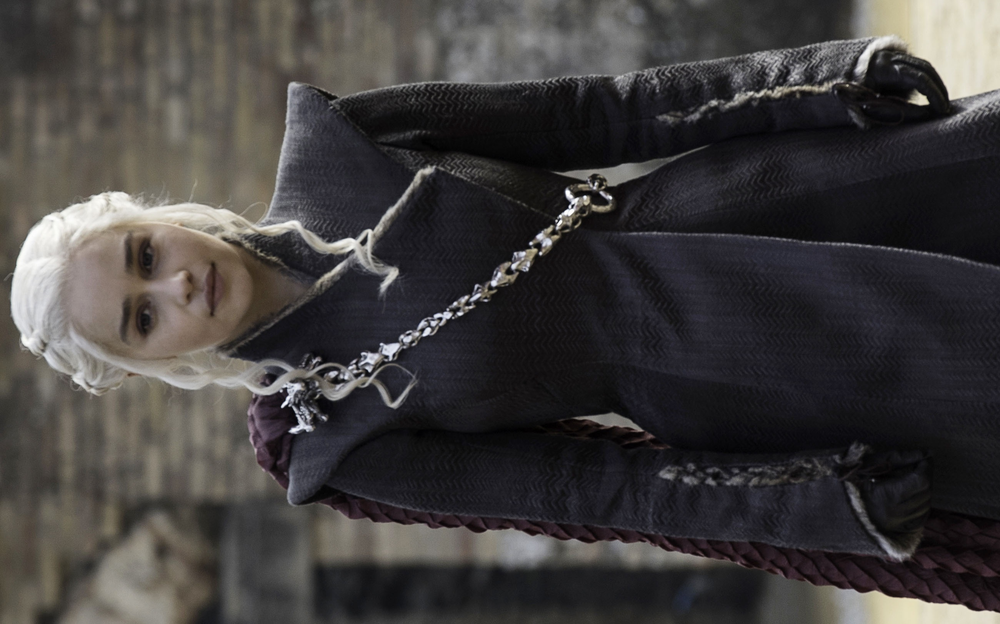

In [4]:
# Transpose the image 90 degrees
transposed_image = enlarged_image.transpose(Image.ROTATE_90)

# Display the transposed image
display(transposed_image)

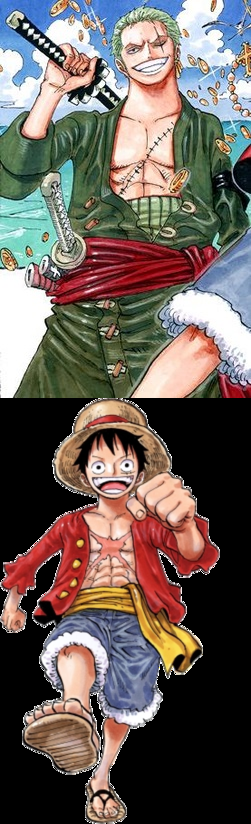

In [5]:
# prompt: combine these 2 image side by side vertically https://upload.wikimedia.org/wikipedia/commons/thumb/7/78/IShowSpeed_at_Chinatown_%28Portrait%29_03.jpg/800px-IShowSpeed_at_Chinatown_%28Portrait%29_03.jpg  https://en.wikipedia.org/wiki/Monkey_D._Luffy#/media/File:Monkey_D_Luffy.png

import numpy as np
from PIL import Image
import requests
from io import BytesIO

def combine_images_vertically(image_urls):
    images = []
    for url in image_urls:
        try:
            response = requests.get(url, stream=True)
            response.raise_for_status()  # Raise an exception for non-200 status codes
            image = Image.open(BytesIO(response.content))
            images.append(image)
        except requests.exceptions.RequestException as e:
            print(f"Error downloading image from {url}: {e}")
            return None
        except Exception as e:
            print(f"Error processing image from {url}: {e}")
            return None

    widths, heights = zip(*(i.size for i in images))

    total_width = max(widths)
    max_height = sum(heights)

    new_im = Image.new('RGB', (total_width, max_height))

    y_offset = 0
    for im in images:
        new_im.paste(im, (0, y_offset))
        y_offset += im.size[1]

    return new_im

image_urls = [
    "https://upload.wikimedia.org/wikipedia/en/a/a4/Roronoa_Zoro.jpg",
    "https://upload.wikimedia.org/wikipedia/en/c/cb/Monkey_D_Luffy.png"
]

combined_image = combine_images_vertically(image_urls)

if combined_image:
    combined_image.show()
    # To save the image:
    # combined_image.save("combined_image.jpg")

    # Display the image (in Colab environment)
combined_image

In [6]:
import numpy as np
from rembg import remove

# Convert the image to RGB
rgb_image = transposed_image.convert("RGB")

# Remove the background
output = remove(rgb_image)

# Display the image without background
display(output)

ModuleNotFoundError: No module named 'rembg'